In [1]:
import warnings
import os
import time
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models

from torchsummary import summary
from torch.utils.data import Dataset, DataLoader

from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2

torch.cuda.empty_cache()

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

warnings.filterwarnings("ignore")

c:\Users\minht\anaconda3\envs\pydl\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\minht\anaconda3\envs\pydl\lib\site-packages\albumentations\__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [2]:
TRAIN_IMG_DIR = "datasets/kvasir_v1/train/images"
TRAIN_MASK_DIR = "datasets/kvasir_v1/train/masks"
VAL_IMG_DIR = "datasets/kvasir_v1/test/images"
VAL_MASK_DIR = "datasets/kvasir_v1/test/masks"

In [3]:
class BloodCellDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None) -> None:
        super(BloodCellDataset, self).__init__()
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(
            self.mask_dir, self.images[index])

        image = np.array(Image.open(image_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"),
                        dtype=np.float32)
        # mask[mask == 255.0] = 1.0
        mask = np.where(mask > 155.0, 1.0, 0.0)

        if self.transform is not None:
            augemantations = self.transform(image=image, mask=mask)
            image = augemantations['image']
            mask = augemantations['mask']
        return image, mask

In [4]:
def get_data_loaders(
        train_dir, train_mask_dir, val_dir, val_maskdir, batch_size,
        train_transform, val_transform):

    train_ds = BloodCellDataset(
        image_dir=train_dir, mask_dir=train_mask_dir,
        transform=train_transform)

    train_loader = DataLoader(
        train_ds,
        batch_size=batch_size,
        shuffle=True,
    )

    val_ds = BloodCellDataset(
        image_dir=val_dir,
        mask_dir=val_maskdir,
        transform=val_transform,
    )

    val_loader = DataLoader(
        val_ds,
        batch_size=batch_size,
        shuffle=False,
    )

    return train_loader, val_loader

In [5]:
train_transform = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [6]:
BATCH_SIZE = 6

train_loader, val_loader = get_data_loaders(
    TRAIN_IMG_DIR,
    TRAIN_MASK_DIR,
    VAL_IMG_DIR,
    VAL_MASK_DIR,
    BATCH_SIZE,
    train_transform,
    val_transforms
)

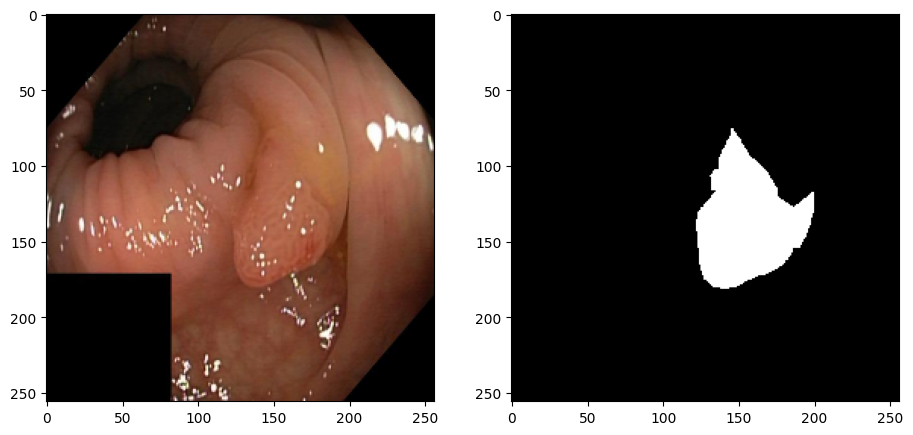

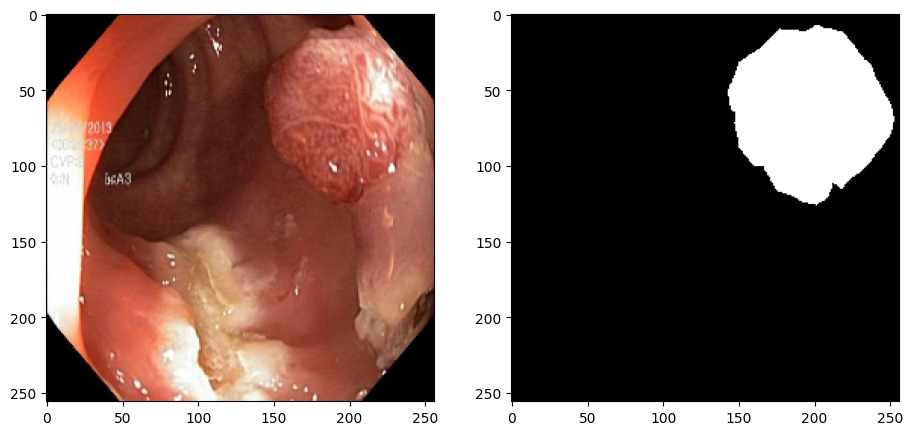

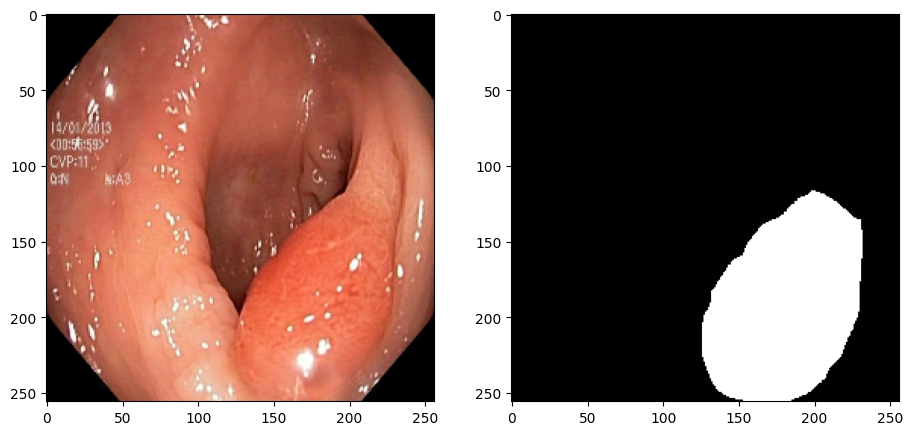

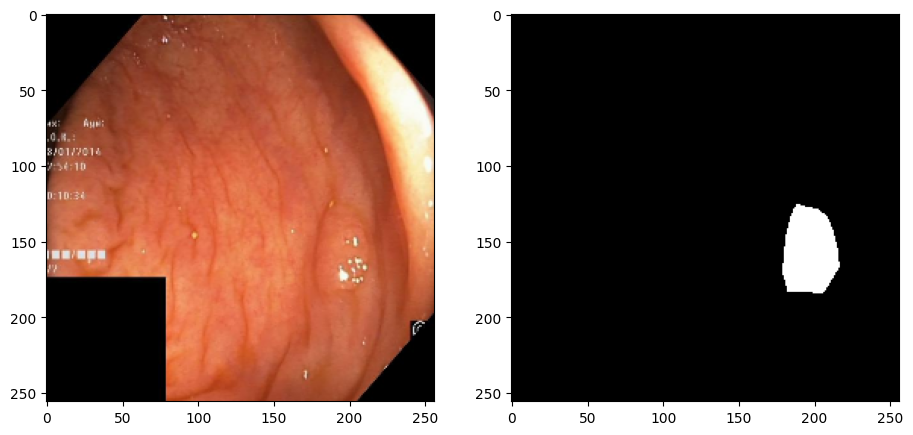

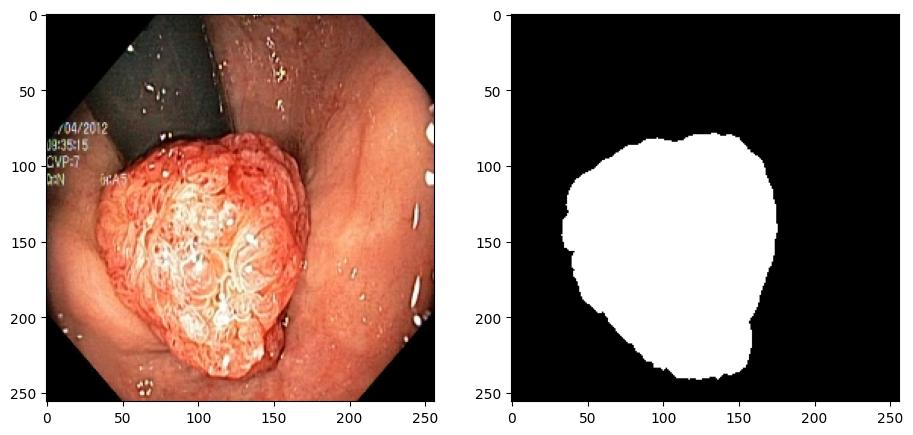

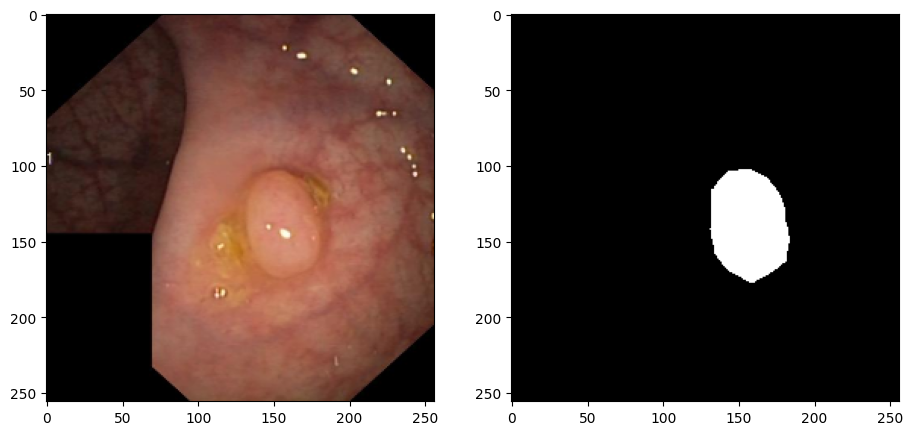

In [7]:
def show_transformed(data_loader):
    batch = next(iter(data_loader))
    images, labels = batch

    for img, mask in zip(images, labels):
        plt.figure(figsize=(11, 11))

        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(img, (1, 2, 0)))

        plt.subplot(1, 2, 2)
        # plt.imshow(mask.reshape(mask.shape[0], mask.shape[1], 1))
        plt.imshow(mask, cmap="gray")

show_transformed(val_loader)

In [8]:
train_loader.dataset[0][0].shape
train_loader.dataset[0][1].shape

torch.Size([256, 256])

In [9]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ResidualBlock, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, stride=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        self.skip = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1) if in_channels != out_channels else nn.Identity()
        
    def forward(self, x):
        residual = self.skip(x)
        x = F.relu(self.bn1(self.conv1(x)))
        x = self.bn2(self.conv2(x))
        x += residual
        return F.relu(x)
    
class DownTransition(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownTransition, self).__init__()
        
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv_block = ResidualBlock(in_channels, out_channels)
    
    def forward(self, x):
        x = self.pool(x)
        x = self.conv_block(x)
        
        return x 

class UpTransition(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UpTransition, self).__init__()
        
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv_block = ResidualBlock(in_channels, out_channels)
    
    def forward(self, x1, x2):
        x1 = self.up(x1)
        x = torch.cat([x1, x2], dim=1)
        x = self.conv_block(x)
        
        return x

In [10]:
class VNet(nn.Module):
    def __init__(self, n_classes, n_channels):
        super(VNet, self).__init__()
        
        self.n_classes = n_classes  
        self.n_channels = n_channels
        
        self.input = ResidualBlock(n_channels, 16)
        
        self.down1 = DownTransition(16, 32)
        self.down2 = DownTransition(32, 64)
        self.down3 = DownTransition(64, 128)   
        self.down4 = DownTransition(128, 256)
        
        
        self.up4 = UpTransition(256, 128)
        self.up3 = UpTransition(128, 64)
        self.up2 = UpTransition(64, 32)
        self.up1 = UpTransition(32, 16)
        
        self.output = nn.Conv2d(16, n_classes, kernel_size=1)
        
    def forward(self, x):
        input = self.input(x)   
        
        down1= self.down1(input)
        down2= self.down2(down1)
        down3= self.down3(down2)
        
        down4= self.down4(down3)
        
        up4 = self.up4(down4, down3)
        up3 = self.up3(up4, down2)
        up2 = self.up2(up3, down1)
        up1 = self.up1(up2, input)
        
        output = self.output(up1)
        return output

In [11]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()
        self.bce_losss = nn.BCEWithLogitsLoss()

    def forward(self, inputs, targets, smooth=1):
        BCE = self.bce_losss(inputs, targets)
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(
            inputs.sum() + targets.sum() + smooth)
        Dice_BCE = BCE + dice_loss
        return Dice_BCE
    
class IOU(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(IOU, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection

        IoU = (intersection + smooth)/(union + smooth)
        return IoU

In [12]:
model = VNet(n_classes=1, n_channels=3).to(DEVICE)
loss_fn = DiceBCELoss()

iou_fn = IOU()
scaler = torch.cuda.amp.GradScaler()
LEARNING_RATE = 1e-4
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_iou = []
train_loss = []
train_dice = []

def save_checkpoint(state, filename="model_VNet.pth.tar"):
    print("=> Saving checkpoint")
    # torch.save(state, filename)

In [13]:
model

VNet(
  (input): ResidualBlock(
    (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (skip): Conv2d(3, 16, kernel_size=(1, 1), stride=(1, 1))
  )
  (down1): DownTransition(
    (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv_block): ResidualBlock(
      (conv1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (skip): Conv2d(16, 32, kernel_size=(1, 1), stride=(1, 1))
    )

In [14]:
print(model)

VNet(
  (input): ResidualBlock(
    (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (skip): Conv2d(3, 16, kernel_size=(1, 1), stride=(1, 1))
  )
  (down1): DownTransition(
    (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv_block): ResidualBlock(
      (conv1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (skip): Conv2d(16, 32, kernel_size=(1, 1), stride=(1, 1))
    )

In [15]:
start_time = time.time()

# let's train it just for 2 epochs
NUM_EPOCHS = 22

for epoch in range(NUM_EPOCHS):
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}")

    iterations = 0
    iter_loss = 0.0
    iter_iou = 0.0

    batch_loop = tqdm(train_loader)
    for batch_idx, (data, targets) in enumerate(batch_loop):

        data = data.to(device=DEVICE)
        targets = targets.float().unsqueeze(1).to(device=DEVICE)

        with torch.cuda.amp.autocast():
            predictions = model(data)
            loss = loss_fn(predictions, targets)
            iou = iou_fn(predictions, targets)

            iter_loss += loss.item()
            iter_iou += iou.item()

        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        iterations += 1
        batch_loop.set_postfix(diceloss=loss.item(), iou=iou.item())

    train_loss.append(iter_loss / iterations)
    train_iou.append(iter_iou / iterations)
    # print(
    #     f"Epoch: {epoch+1}/{NUM_EPOCHS}, Training loss: {round(train_loss[-1] , 3)}")
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}, IoU score: {iter_iou / iterations}")

    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict()
    }
    # save_checkpoint(checkpoint)

    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()
            num_correct += (preds == y).sum()
            num_pixels += torch.numel(preds)
            dice_score += (2 * (preds * y).sum()) / (
                (preds + y).sum() + 1e-8
            )

    # print(
    #     f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.2f}"
    # )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Total num_correct/num_pixels: {num_correct}/{num_pixels} => {num_correct/num_pixels}"
    )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Dice score: {dice_score / len(val_loader)}")
    train_dice.append(dice_score / len(val_loader))
    model.train()

print("done ..")

end_time = time.time()
training_time = end_time - start_time
print(
    f"The training time of the VNET model is: {training_time:.2f} seconds")

Epoch: 1/22


100%|██████████| 134/134 [04:45<00:00,  2.13s/it, diceloss=1.27, iou=0.114] 


Epoch: 1/22, IoU score: 0.18463436619781737
Epoch: 1/22, Total num_correct/num_pixels: 10777169/13107200 => 0.822232723236084
Epoch: 1/22, Dice score: 0.5108504936444448
Epoch: 2/22


100%|██████████| 134/134 [05:02<00:00,  2.26s/it, diceloss=1.04, iou=0.184] 


Epoch: 2/22, IoU score: 0.2862584628164768
Epoch: 2/22, Total num_correct/num_pixels: 11628839/13107200 => 0.8872100114822388
Epoch: 2/22, Dice score: 0.4967105303176297
Epoch: 3/22


100%|██████████| 134/134 [06:25<00:00,  2.88s/it, diceloss=0.77, iou=0.431] 


Epoch: 3/22, IoU score: 0.3825826990737844
Epoch: 3/22, Total num_correct/num_pixels: 11687192/13107200 => 0.8916620016098022
Epoch: 3/22, Dice score: 0.5698270540516142
Epoch: 4/22


100%|██████████| 134/134 [05:09<00:00,  2.31s/it, diceloss=0.626, iou=0.38] 


Epoch: 4/22, IoU score: 0.43450632357775276
Epoch: 4/22, Total num_correct/num_pixels: 11843585/13107200 => 0.9035938382148743
Epoch: 4/22, Dice score: 0.5764118356440424
Epoch: 5/22


100%|██████████| 134/134 [06:16<00:00,  2.81s/it, diceloss=0.431, iou=0.568]


Epoch: 5/22, IoU score: 0.4722611161310281
Epoch: 5/22, Total num_correct/num_pixels: 11847872/13107200 => 0.9039208889007568
Epoch: 5/22, Dice score: 0.6699233218805073
Epoch: 6/22


100%|██████████| 134/134 [05:02<00:00,  2.26s/it, diceloss=0.804, iou=0.431]


Epoch: 6/22, IoU score: 0.4932240474579939
Epoch: 6/22, Total num_correct/num_pixels: 11891514/13107200 => 0.9072505235671997
Epoch: 6/22, Dice score: 0.6455134911891502
Epoch: 7/22


100%|██████████| 134/134 [06:37<00:00,  2.96s/it, diceloss=0.529, iou=0.428]


Epoch: 7/22, IoU score: 0.5174775062434709
Epoch: 7/22, Total num_correct/num_pixels: 12089198/13107200 => 0.9223325848579407
Epoch: 7/22, Dice score: 0.6955061536608397
Epoch: 8/22


100%|██████████| 134/134 [05:00<00:00,  2.24s/it, diceloss=0.322, iou=0.688]


Epoch: 8/22, IoU score: 0.5672734866836178
Epoch: 8/22, Total num_correct/num_pixels: 11442289/13107200 => 0.8729773759841919
Epoch: 8/22, Dice score: 0.6486424914636869
Epoch: 9/22


100%|██████████| 134/134 [06:40<00:00,  2.99s/it, diceloss=0.681, iou=0.582]


Epoch: 9/22, IoU score: 0.5799016216352805
Epoch: 9/22, Total num_correct/num_pixels: 11921564/13107200 => 0.9095431566238403
Epoch: 9/22, Dice score: 0.7034734751158158
Epoch: 10/22


100%|██████████| 134/134 [05:21<00:00,  2.40s/it, diceloss=0.212, iou=0.78] 


Epoch: 10/22, IoU score: 0.62667712991807
Epoch: 10/22, Total num_correct/num_pixels: 11930580/13107200 => 0.9102309942245483
Epoch: 10/22, Dice score: 0.7038349183930716
Epoch: 11/22


100%|██████████| 134/134 [06:32<00:00,  2.93s/it, diceloss=0.16, iou=0.773] 


Epoch: 11/22, IoU score: 0.6562117938675097
Epoch: 11/22, Total num_correct/num_pixels: 12082349/13107200 => 0.9218100905418396
Epoch: 11/22, Dice score: 0.7211599311749803
Epoch: 12/22


100%|██████████| 134/134 [04:51<00:00,  2.18s/it, diceloss=0.294, iou=0.754]


Epoch: 12/22, IoU score: 0.6775765663652278
Epoch: 12/22, Total num_correct/num_pixels: 12140682/13107200 => 0.9262605309486389
Epoch: 12/22, Dice score: 0.7144095213744979
Epoch: 13/22


100%|██████████| 134/134 [06:01<00:00,  2.70s/it, diceloss=0.114, iou=0.858]


Epoch: 13/22, IoU score: 0.7108500893436261
Epoch: 13/22, Total num_correct/num_pixels: 12126876/13107200 => 0.9252071976661682
Epoch: 13/22, Dice score: 0.7377103280721957
Epoch: 14/22


100%|██████████| 134/134 [04:42<00:00,  2.11s/it, diceloss=0.608, iou=0.412]


Epoch: 14/22, IoU score: 0.7433916643929126
Epoch: 14/22, Total num_correct/num_pixels: 12192144/13107200 => 0.9301867485046387
Epoch: 14/22, Dice score: 0.7132672720596245
Epoch: 15/22


100%|██████████| 134/134 [05:49<00:00,  2.61s/it, diceloss=0.182, iou=0.789]


Epoch: 15/22, IoU score: 0.7628829839514263
Epoch: 15/22, Total num_correct/num_pixels: 12148657/13107200 => 0.9268689751625061
Epoch: 15/22, Dice score: 0.6982024722942471
Epoch: 16/22


100%|██████████| 134/134 [04:37<00:00,  2.07s/it, diceloss=1.11, iou=0.173] 


Epoch: 16/22, IoU score: 0.7901818105089131
Epoch: 16/22, Total num_correct/num_pixels: 12179045/13107200 => 0.9291874170303345
Epoch: 16/22, Dice score: 0.7238315131257493
Epoch: 17/22


100%|██████████| 134/134 [05:46<00:00,  2.58s/it, diceloss=0.205, iou=0.75] 


Epoch: 17/22, IoU score: 0.7997072383539
Epoch: 17/22, Total num_correct/num_pixels: 12087097/13107200 => 0.9221723079681396
Epoch: 17/22, Dice score: 0.7073503473906442
Epoch: 18/22


100%|██████████| 134/134 [04:41<00:00,  2.10s/it, diceloss=0.0742, iou=0.903]


Epoch: 18/22, IoU score: 0.8226531855205992
Epoch: 18/22, Total num_correct/num_pixels: 12196550/13107200 => 0.9305229187011719
Epoch: 18/22, Dice score: 0.726898585348596
Epoch: 19/22


100%|██████████| 134/134 [06:11<00:00,  2.77s/it, diceloss=0.0956, iou=0.882]


Epoch: 19/22, IoU score: 0.8484065884084844
Epoch: 19/22, Total num_correct/num_pixels: 12180990/13107200 => 0.9293357729911804
Epoch: 19/22, Dice score: 0.7309562414882207
Epoch: 20/22


100%|██████████| 134/134 [06:22<00:00,  2.86s/it, diceloss=0.231, iou=0.772] 


Epoch: 20/22, IoU score: 0.8402780374484276
Epoch: 20/22, Total num_correct/num_pixels: 12036015/13107200 => 0.9182750582695007
Epoch: 20/22, Dice score: 0.7290384661726113
Epoch: 21/22


100%|██████████| 134/134 [04:54<00:00,  2.20s/it, diceloss=0.0821, iou=0.901]


Epoch: 21/22, IoU score: 0.8662849041953016
Epoch: 21/22, Total num_correct/num_pixels: 12163086/13107200 => 0.9279698133468628
Epoch: 21/22, Dice score: 0.7304477912799906
Epoch: 22/22


100%|██████████| 134/134 [05:33<00:00,  2.49s/it, diceloss=0.136, iou=0.901] 


Epoch: 22/22, IoU score: 0.8826739329900315
Epoch: 22/22, Total num_correct/num_pixels: 12167908/13107200 => 0.9283376932144165
Epoch: 22/22, Dice score: 0.7142263712727636
done ..
The training time of the VNET model is: 8011.14 seconds


In [16]:
print(train_loss)

[1.2241390930182898, 0.9252093772389995, 0.7503387269689076, 0.6667298078536987, 0.6125540355248238, 0.5823191695693714, 0.5470139991436431, 0.4846215277020611, 0.4659163840671084, 0.4038911519655541, 0.3720323632457363, 0.3395891468693961, 0.2990207166146876, 0.264075816178055, 0.23980698228549602, 0.20963180632288778, 0.1982773959414283, 0.16953309703229077, 0.14268447619987956, 0.15001577372426417, 0.1241935460425135, 0.1058774494301917]


In [17]:
print(train_iou)

[0.18463436619781737, 0.2862584628164768, 0.3825826990737844, 0.43450632357775276, 0.4722611161310281, 0.4932240474579939, 0.5174775062434709, 0.5672734866836178, 0.5799016216352805, 0.62667712991807, 0.6562117938675097, 0.6775765663652278, 0.7108500893436261, 0.7433916643929126, 0.7628829839514263, 0.7901818105089131, 0.7997072383539, 0.8226531855205992, 0.8484065884084844, 0.8402780374484276, 0.8662849041953016, 0.8826739329900315]


In [18]:
print(train_dice)

[tensor(0.5109, dtype=torch.float64), tensor(0.4967, dtype=torch.float64), tensor(0.5698, dtype=torch.float64), tensor(0.5764, dtype=torch.float64), tensor(0.6699, dtype=torch.float64), tensor(0.6455, dtype=torch.float64), tensor(0.6955, dtype=torch.float64), tensor(0.6486, dtype=torch.float64), tensor(0.7035, dtype=torch.float64), tensor(0.7038, dtype=torch.float64), tensor(0.7212, dtype=torch.float64), tensor(0.7144, dtype=torch.float64), tensor(0.7377, dtype=torch.float64), tensor(0.7133, dtype=torch.float64), tensor(0.6982, dtype=torch.float64), tensor(0.7238, dtype=torch.float64), tensor(0.7074, dtype=torch.float64), tensor(0.7269, dtype=torch.float64), tensor(0.7310, dtype=torch.float64), tensor(0.7290, dtype=torch.float64), tensor(0.7304, dtype=torch.float64), tensor(0.7142, dtype=torch.float64)]


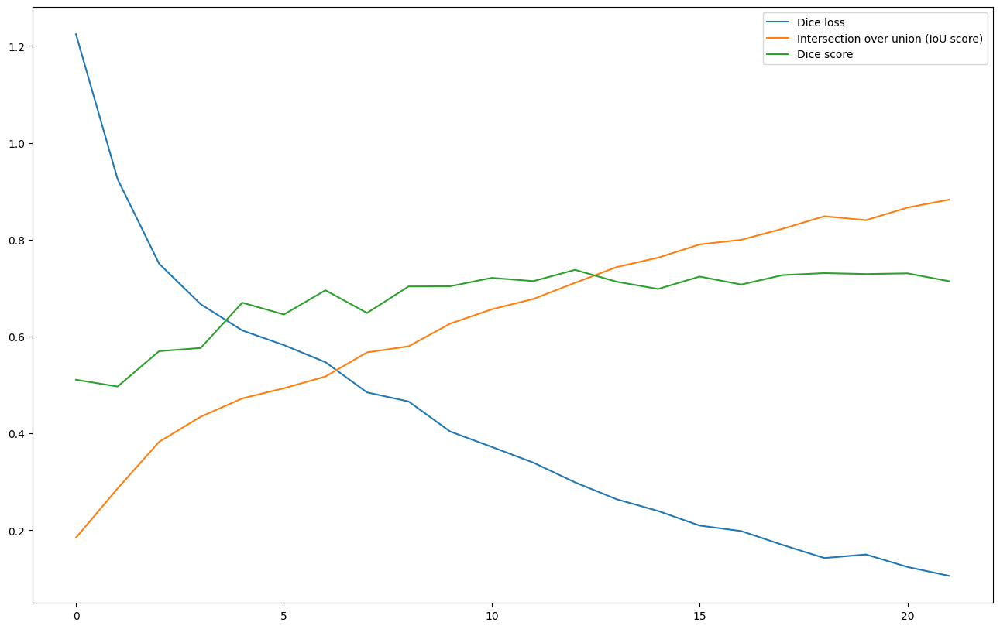

In [19]:
f = plt.figure(figsize=(16, 10))
plt.plot(train_loss, label='Dice loss')
plt.plot(train_iou, label='Intersection over union (IoU score)')
plt.plot(train_dice, label='Dice score')
plt.legend()
plt.show()

In [20]:
def test_model(model, val_loader, device):
    model.eval()
    dice_score = 0
    iou_metric = IOU()
    iou_score = 0

    with torch.no_grad():
        for x, y in tqdm(val_loader, desc="Testing"):
            x = x.to(device)
            y = y.to(device).unsqueeze(1)

            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            dice_score += (2 * (preds_binary * y).sum()) / (
                (preds_binary + y).sum() + 1e-8
            )
            iou_score += iou_metric(preds_binary, y)

    avg_dice = dice_score / len(val_loader)
    avg_iou = iou_score / len(val_loader)

    print(f"Average Dice Score: {avg_dice:.4f}")
    print(f"Average IoU Score: {avg_iou:.4f}")

    return avg_dice, avg_iou

avg_dice, avg_iou = test_model(model, val_loader, DEVICE)

Testing: 100%|██████████| 34/34 [00:30<00:00,  1.10it/s]

Average Dice Score: 0.7142
Average IoU Score: 0.1612


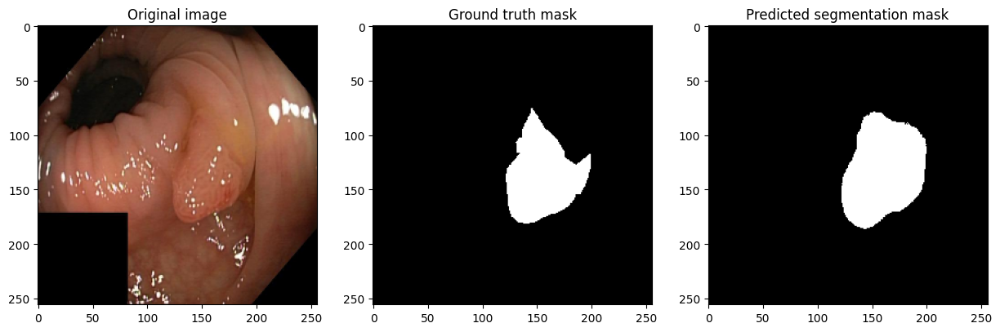

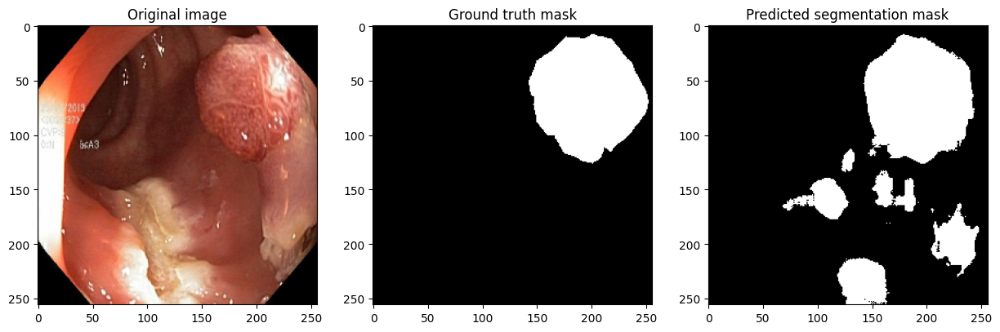

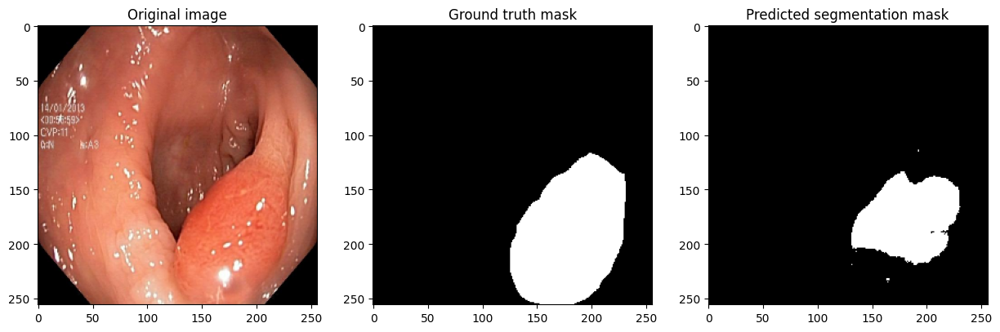

In [21]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(15, 5))

                plt.subplot(1, 3, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                plt.subplot(1, 3, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                plt.subplot(1, 3, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.show()
                samples += 1

            if samples >= num_samples:
                break
            
visualize_predictions(model, val_loader, DEVICE)

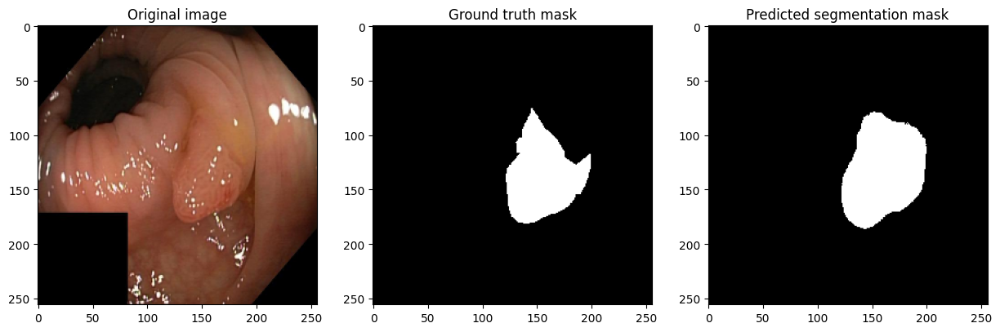

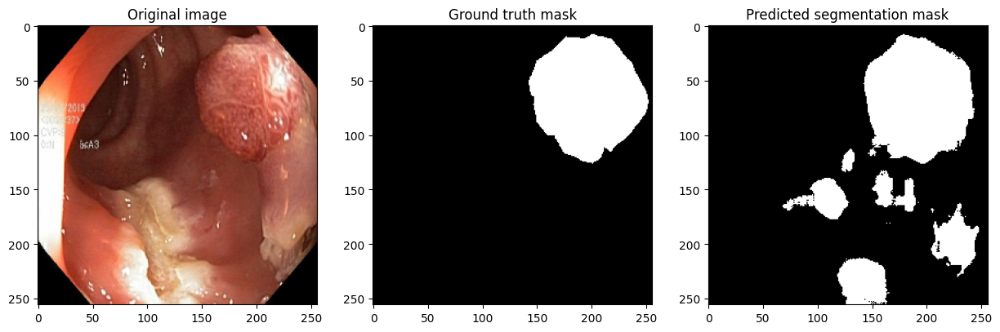

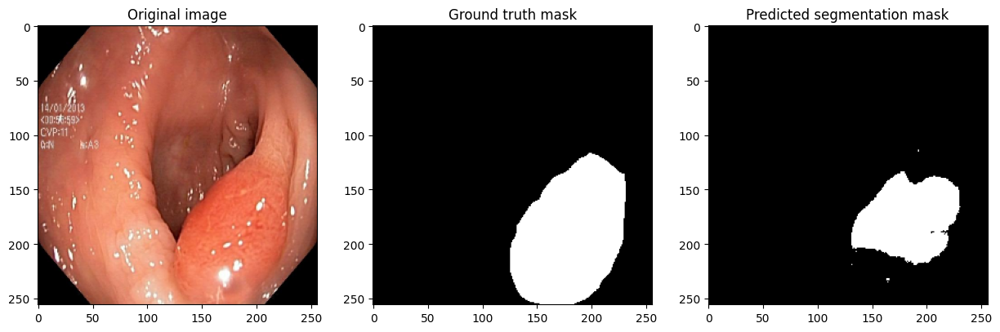

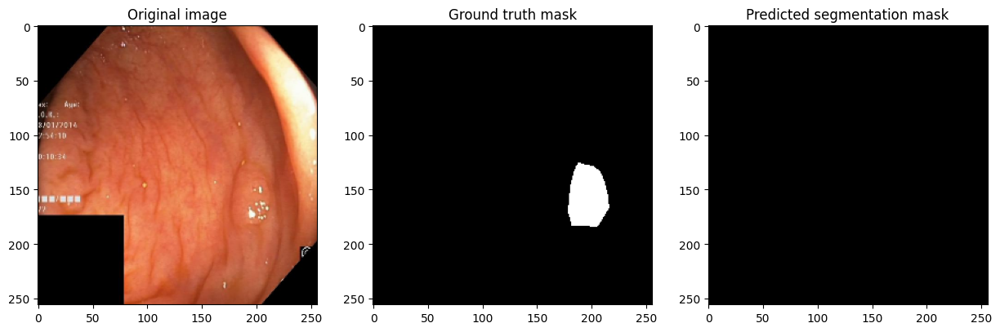

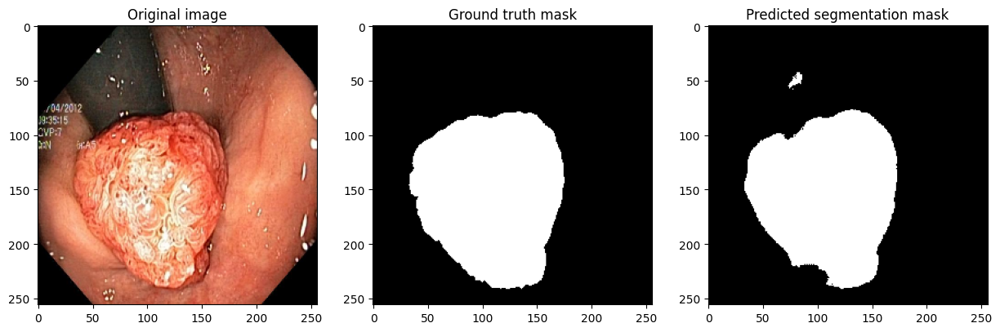

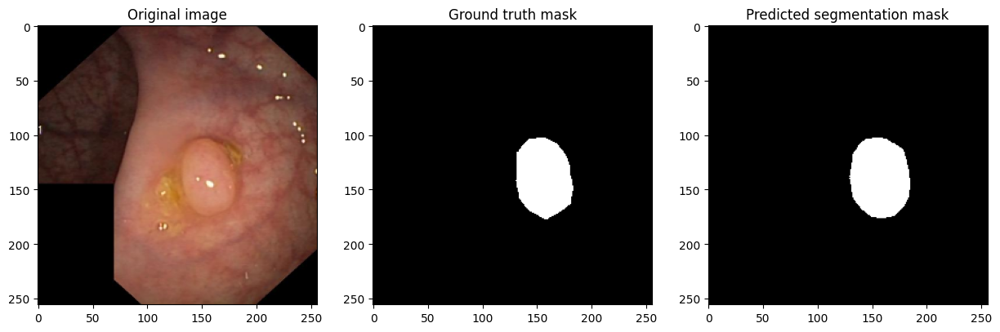

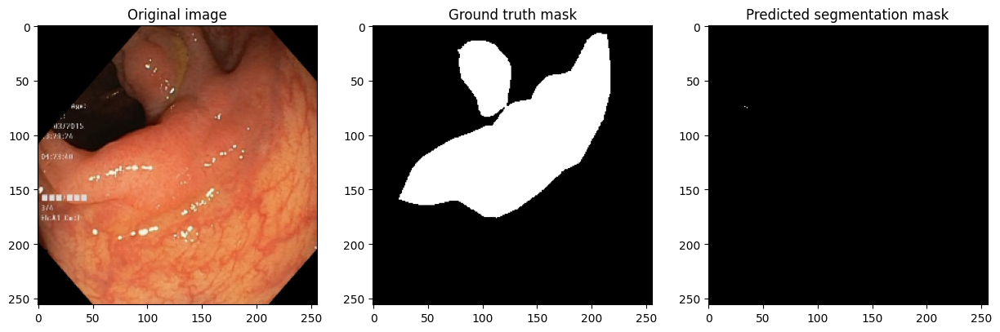

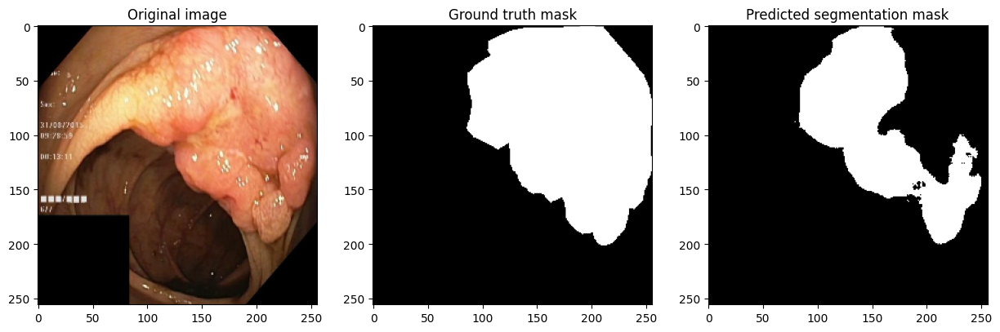

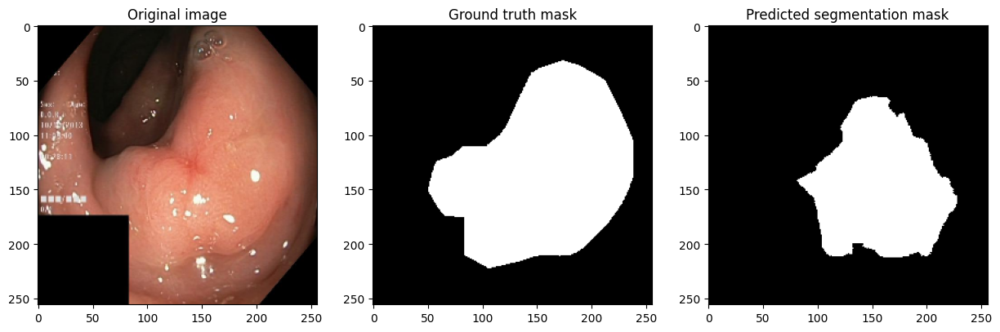

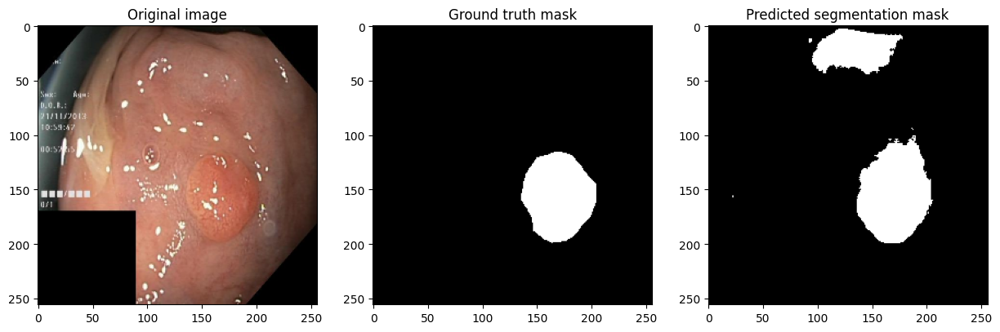

In [22]:
visualize_predictions(model, val_loader, DEVICE, num_samples=10)

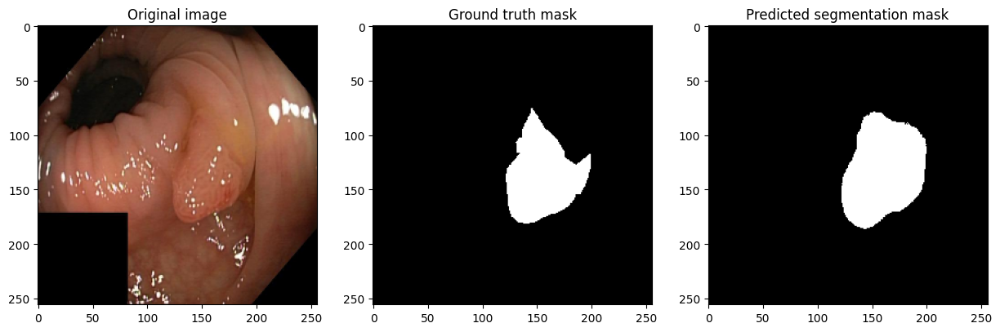

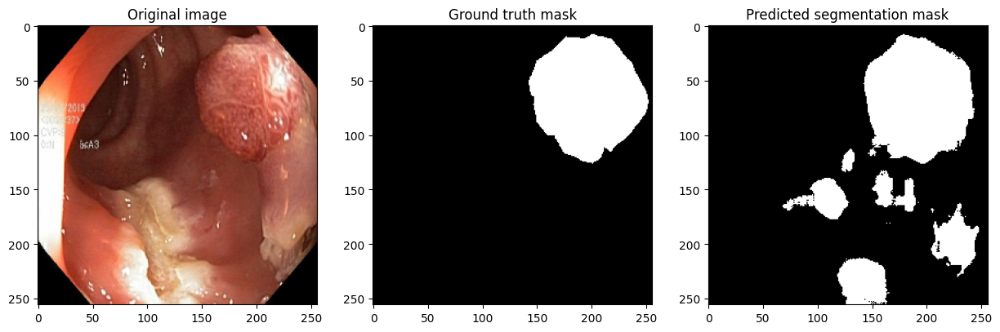

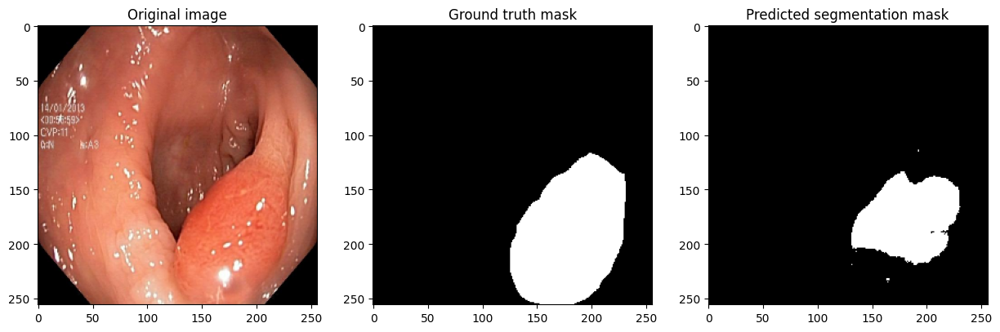

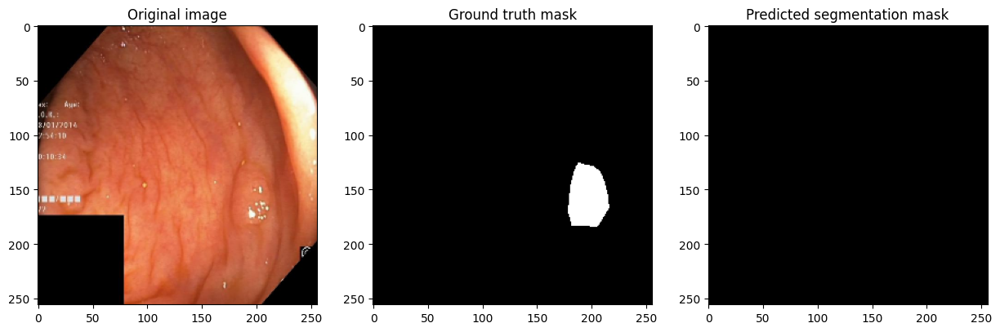

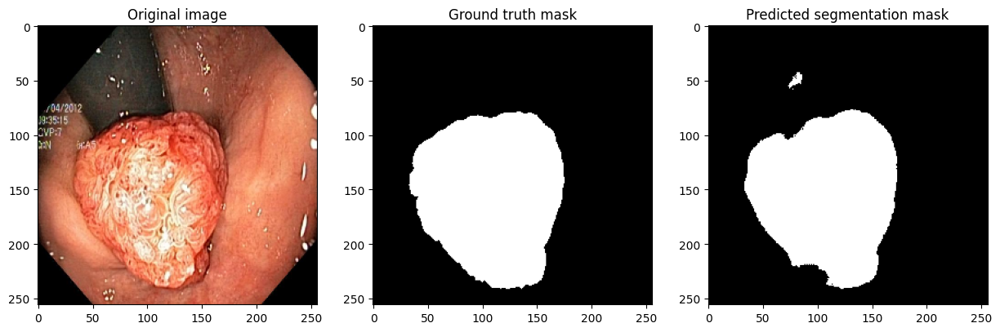

...

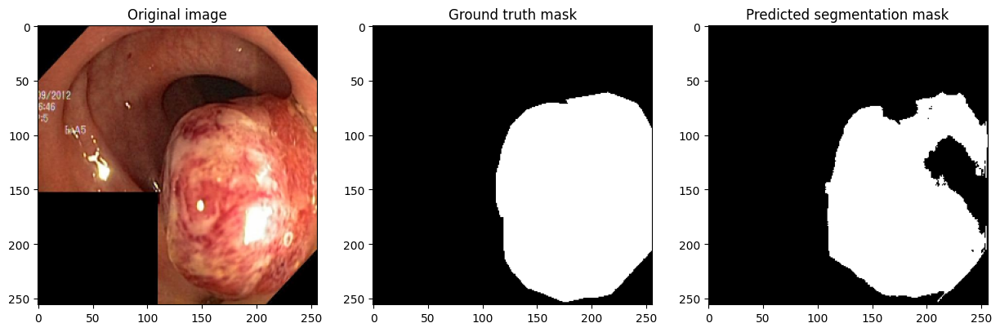

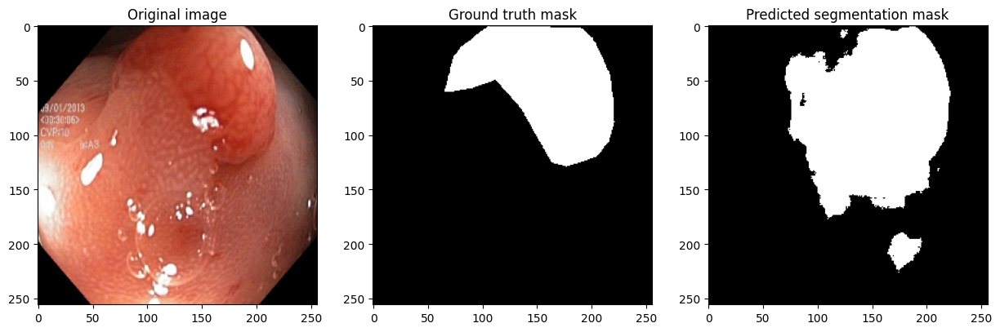

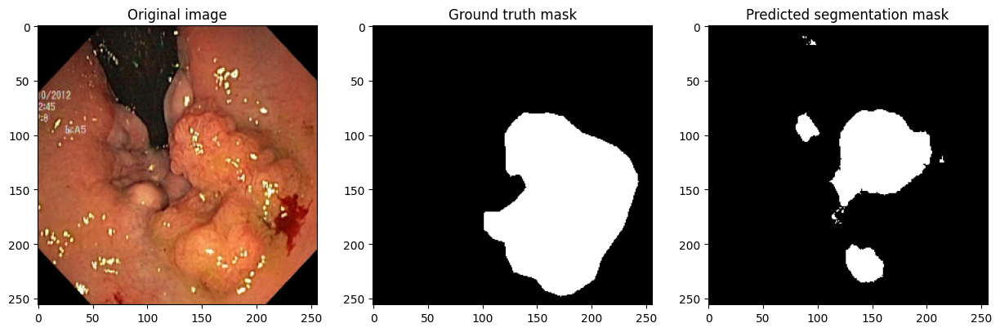

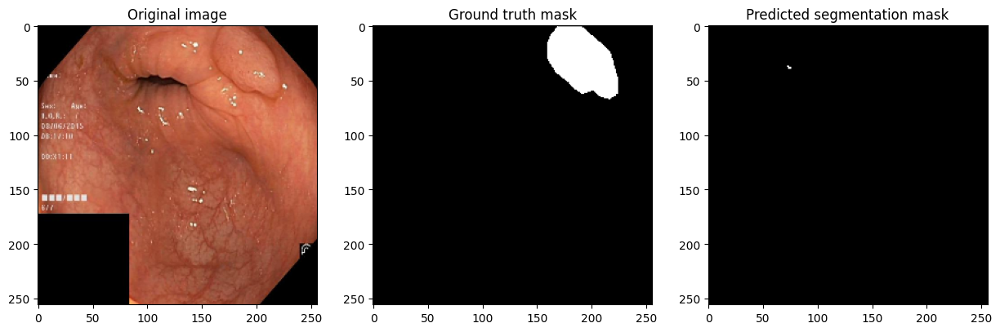

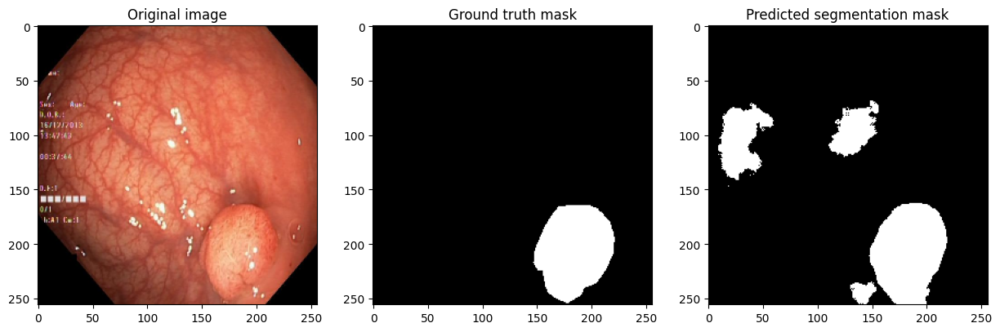

In [23]:
visualize_predictions(model, val_loader, DEVICE, num_samples=50)

In [24]:
# visualize_predictions(model, val_loader, DEVICE, num_samples=100)

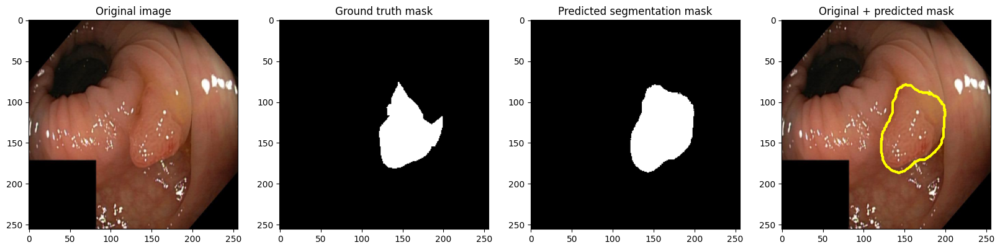

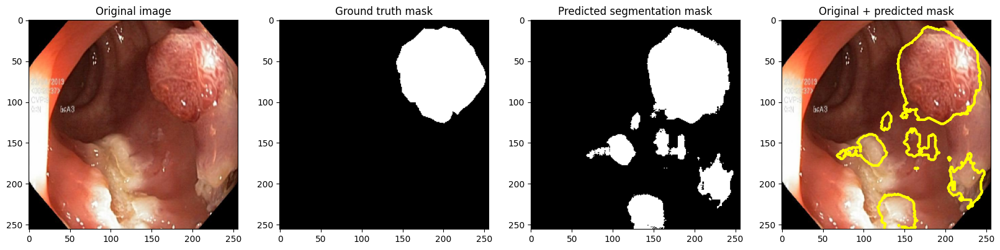

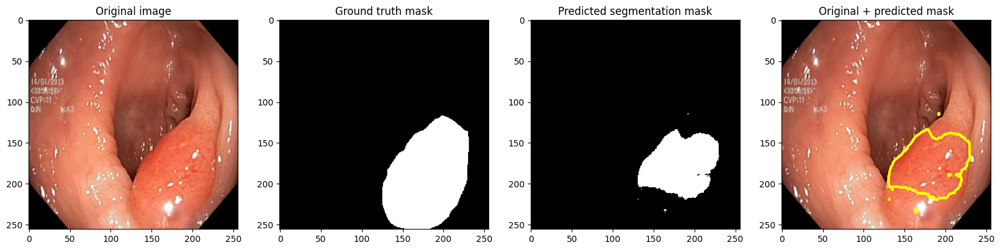

In [25]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(20, 5))

                plt.subplot(1, 4, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                plt.subplot(1, 4, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                plt.subplot(1, 4, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.subplot(1, 4, 4)
                plt.title("Original + predicted mask")
                original_image = np.transpose(x[i].cpu().numpy(), (1, 2, 0))
                plt.imshow(original_image)

                mask = preds_binary[i].cpu().numpy().squeeze()
                mask_border = np.zeros_like(mask)
                mask_border[mask == 1] = 1
                plt.contour(mask_border, colors='yellow', linewidths=2)

                plt.show()
                samples += 1

            if samples >= num_samples:
                break


visualize_predictions(model, val_loader, DEVICE)

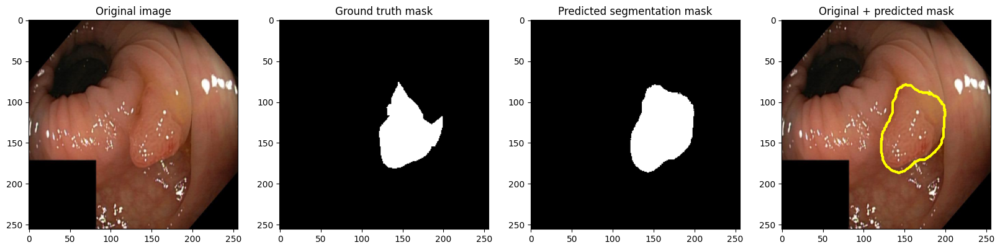

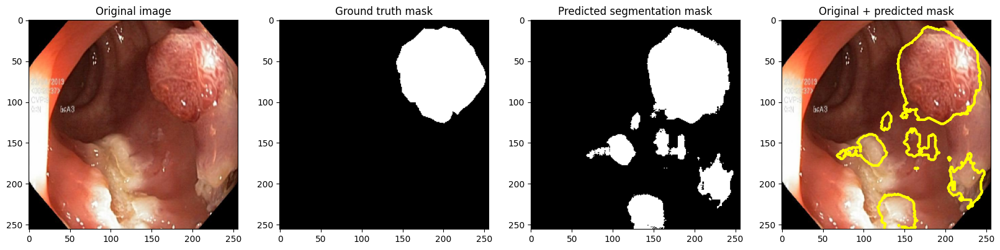

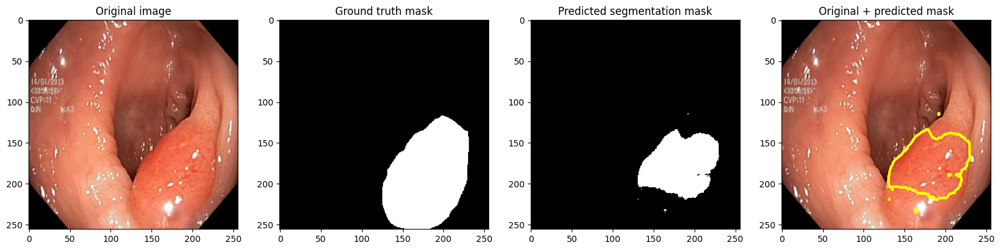

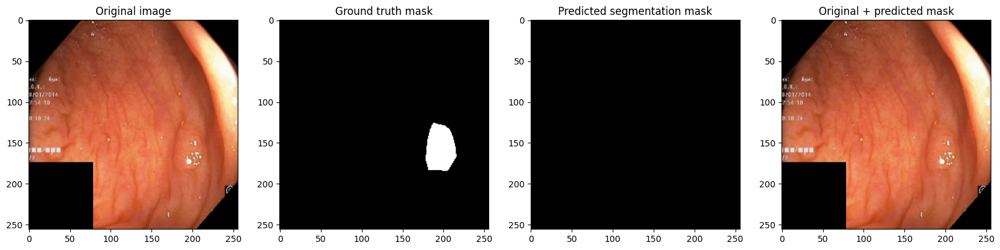

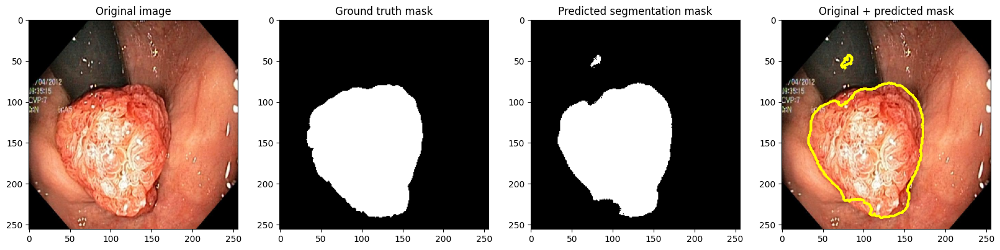

...

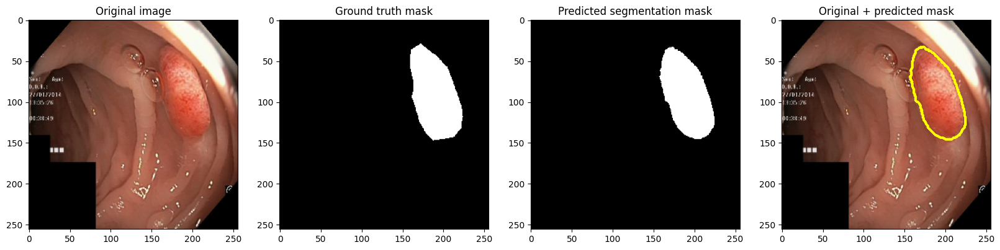

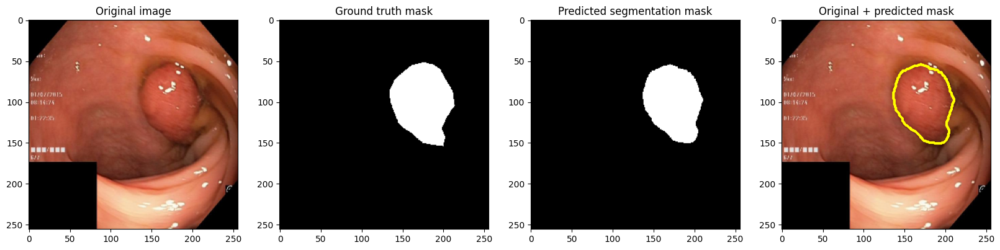

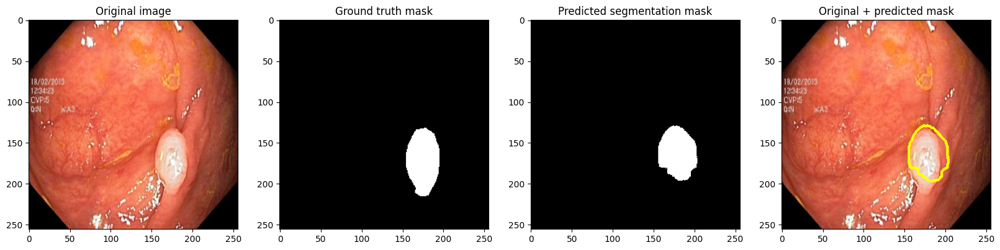

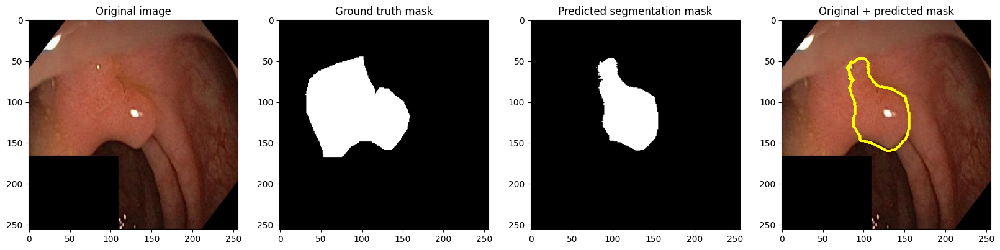

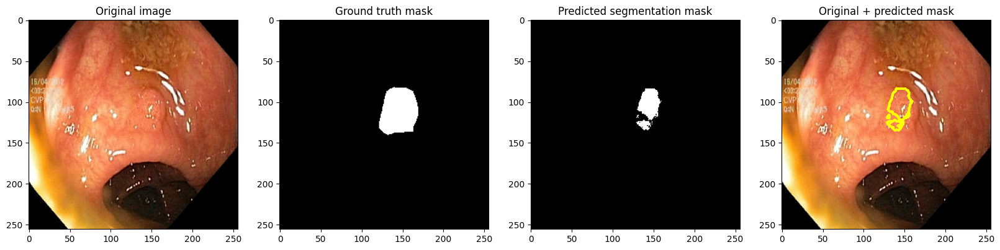

In [26]:
visualize_predictions(model, val_loader, DEVICE, num_samples=100)